In [74]:
import opticalflow3D
import warnings
import numpy as np
import nibabel as nib
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from numba.core.errors import NumbaPerformanceWarning
from IPython.display import HTML

warnings.filterwarnings("ignore", category=NumbaPerformanceWarning)
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128


def load_subject_single_visit(
    root_dir: str = "/media/minghui/Data/Datasets/NMSS Study/ASCEND",
    subject: str = "AA-3974",
    visit: str = "baseline",
    modality: str = "flair",
    registration: str = "lin",
    load_seg: bool = False,
    load_stats: bool = False,
):

    if load_stats:
        load_seg = True
    
    img = nib.load(
        f"{root_dir}/agg_{modality}_{registration}_hm/{subject}_{visit}_{modality}_mni_{registration}_hm.nii.gz"
    ).get_fdata()
    if load_seg:
        seg = nib.load(
            f"{root_dir}/lst_lesion_segmentation/{subject}/{visit}/{subject}_{visit}_{modality}_desc_annotated_seg_lst.nii.gz"
        ).get_fdata()
    if load_stats:
        stats = pd.read_csv(
            f"{root_dir}/lst_lesion_segmentation/{subject}/{visit}/{subject}_{visit}_annotated_lesion_stats.csv"
        )
        total = pd.read_csv(
            f"{root_dir}/lst_lesion_segmentation/{subject}/{visit}/{subject}_{visit}_lesion_stats.csv"
        )
        # merge the total stats with the individual stats
        total["Region"] = "Total" 
        stats = pd.concat([stats, total], ignore_index=True)
    
    if load_seg and load_stats:
        return img, seg, stats
    elif load_seg:
        return img, seg
    else:
        return img


# compute the optical flow between two images
def compute_optical_flow(img1, img2, farneback=None, set_nan_to_zero=True):
    if farneback is None:
        farneback = opticalflow3D.Farneback3D()
    vz, vy, vx, confidence = farneback.calculate_flow(img1, img2)

    if set_nan_to_zero:
        vz = np.nan_to_num(vz)
        vy = np.nan_to_num(vy)
        vx = np.nan_to_num(vx)
        confidence = np.nan_to_num(confidence)

    return vz, vy, vx, confidence


def save_flow(vz, vy, vx, confidence, prefix=""):
    opticalflow3D.helpers.save_displacements(f"{prefix}_vectors.npz", vz, vy, vx)
    opticalflow3D.helpers.save_confidence(f"{prefix}_confidence.npz", confidence)


# visualize the baseline image using animation along the z-axis
def visualize_image(img, name="Baseline Image"):
    fig, ax = plt.subplots()
    ax.set_title(name)
    ax.axis("off")
    im = ax.imshow(img[:, :, 0], cmap="gray", vmin=0, vmax=255)

    def update(i):
        im.set_data(img[:, :, i])
        return im

    ani = FuncAnimation(fig, update, frames=range(img.shape[2]), interval=100)

    return HTML(ani.to_jshtml())

# visualize the lesions using animation along the z-axis
def visualize_lesion(img, name="Lesions"):
    fig, ax = plt.subplots()
    ax.set_title(name)
    ax.axis("off")
    im = ax.imshow(img[:, :, 0], cmap="gray")

    def update(i):
        im.set_data(img[:, :, i])
        return im

    ani = FuncAnimation(fig, update, frames=range(img.shape[2]), interval=100)

    return HTML(ani.to_jshtml())



def visualize_flow_2d(img1, img2, vz, vy, vx, confidence):
    fig, ax = plt.subplots(2, 3)
    fig.set_size_inches(12, 8)
    ax[0, 0].set_title("Image 1")
    ax[0, 0].axis("off")
    ax[0, 1].set_title("Image 2")
    ax[0, 1].axis("off")
    ax[0, 2].set_title("Confidence")
    ax[0, 2].axis("off")
    ax[1, 0].set_title("Vx")
    ax[1, 0].axis("off")
    ax[1, 1].set_title("Vy")
    ax[1, 1].axis("off")
    ax[1, 2].set_title("Vz")
    ax[1, 2].axis("off")

    im0 = ax[0, 0].imshow(img1[:, :, 0], cmap="gray", vmin=0, vmax=255)
    im1 = ax[0, 1].imshow(img2[:, :, 0], cmap="gray", vmin=0, vmax=255)
    im2 = ax[0, 2].imshow(confidence[:, :, 0], cmap="gray")
    im3 = ax[1, 0].imshow(vx[:, :, 0], cmap="seismic", vmin=-10, vmax=10)
    im4 = ax[1, 1].imshow(vy[:, :, 0], cmap="seismic", vmin=-10, vmax=10)
    im5 = ax[1, 2].imshow(vz[:, :, 0], cmap="seismic", vmin=-10, vmax=10)

    fig.colorbar(im0, ax=ax[0, 0])
    fig.colorbar(im1, ax=ax[0, 1])
    fig.colorbar(im2, ax=ax[0, 2])
    fig.colorbar(im3, ax=ax[1, 0])
    fig.colorbar(im4, ax=ax[1, 1])
    fig.colorbar(im5, ax=ax[1, 2])

    def update(i):
        im0.set_data(img1[:, :, i])
        im1.set_data(img2[:, :, i])
        im2.set_data(confidence[:, :, i])
        im3.set_data(vx[:, :, i])
        im4.set_data(vy[:, :, i])
        im5.set_data(vz[:, :, i])
        return im0, im1, im2, im3, im4, im5
    
    ani = FuncAnimation(fig, update, frames=range(vz.shape[2]), interval=100)
    return HTML(ani.to_jshtml())

def visualize_flow_field_and_image(img1, img2, vz, vy, vx):
    fig, ax = plt.subplots(1, 3)
    fig.set_size_inches(18, 6)
    ax[0].set_title("Image 1")
    ax[0].axis("off")
    ax[1].set_title("Image 2")
    ax[1].axis("off")
    ax[2].set_title("Flow Field")
    ax[2].axis("off")

    im0 = ax[0].imshow(img1[:, :, 0], cmap="gray", vmin=0, vmax=255)
    im1 = ax[1].imshow(img2[:, :, 0], cmap="gray", vmin=0, vmax=255)

    # subsample the flow field before displaying
    scale = 5
    vx = vx[::scale, ::scale, :]
    vy = vy[::scale, ::scale, :]

    # reverse dim 0 and 1 to match the image dimensions
    vx = np.transpose(vx, (1, 0, 2))
    vy = np.transpose(vy, (1, 0, 2))

    # X, Y = np.meshgrid(np.arange(vx.shape[1]), np.arange(vx.shape[0]))
    # im2 = ax[2].quiver(X, Y, vx[:, :, 0], vy[:, :, 0], scale=1, scale_units="xy", angles='xy')
    im2 = ax[2].quiver(vx[:, :, 0], vy[:, :, 0])

    def update(i):
        im0.set_data(img1[:, :, i])
        im1.set_data(img2[:, :, i])
        # ax[2].quiver(X, Y, vx[:, :, i], vy[:, :, i], scale=1, scale_units="xy", angles='xy')
        im2.set_UVC(vx[:, :, i], vy[:, :, i])
        return im0, im1, im2

    ani = FuncAnimation(fig, update, frames=range(img1.shape[2]), interval=100)
    return HTML(ani.to_jshtml())

def visualize_flow_field(vz, vy, vx):
    fig, ax = plt.subplots()
    fig.set_size_inches(12, 8)

    # subsample the flow field before displaying
    scale = 5
    vx = vx[::scale, ::scale, :]
    vy = vy[::scale, ::scale, :]

    im = ax.quiver(vx[:, :, 0], vy[:, :, 0], scale=1, scale_units="xy", angles='xy')

    def update(i):
        im.set_UVC(vx[:, :, i], vy[:, :, i])
        return im

    ani = FuncAnimation(fig, update, frames=range(vz.shape[2]), interval=100)
    return HTML(ani.to_jshtml())

# plot the flow vectors in 3D
from mpl_toolkits.mplot3d import Axes3D
def visualize_flow_3d(vz, vy, vx, scale=10):
    fig = plt.figure()
    fig.set_size_inches(12, 8)
    ax = fig.add_subplot(111, projection='3d')

    # scale the flow vectors for better visualization
    vx = vx[::scale, ::scale, ::scale]
    vy = vy[::scale, ::scale, ::scale]
    vz = vz[::scale, ::scale, ::scale]

    x, y, z = np.meshgrid(np.arange(vx.shape[1]), np.arange(vx.shape[0]), np.arange(vx.shape[2]))

    ax.quiver(x, y, z, vx, vy, vz, length=0.1, normalize=True)

    ax.set_title("Optical Flow Vectors")
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")

    plt.show()


def visualize_flow_mag_angle(img1, img2, vz, vy, vx):
    # visualize the optical flow magnitude and angle
    magnitude = np.sqrt(vx**2 + vy**2 + vz**2)
    angle = np.arctan2(vy, vx)

    fig, ax = plt.subplots(2, 2)
    fig.set_size_inches(10, 8)

    ax[0, 0].set_title("Baseline Image")
    ax[0, 1].axis("off")
    ax[0, 1].set_title("Baseline Image")
    ax[0, 1].axis("off")
    ax[1, 0].set_title("Flow magnitude")
    ax[1, 0].axis("off")
    ax[1, 1].set_title("Flow angle")
    ax[1, 1].axis("off")

    im0 = ax[0, 0].imshow(img1[:, :, 0], cmap="gray", vmin=0, vmax=255)
    im1 = ax[0, 1].imshow(img2[:, :, 0], cmap="gray", vmin=0, vmax=255)
    im2 = ax[1, 0].imshow(magnitude[:, :, 0], cmap="gray")
    im3 = ax[1, 1].imshow(angle[:, :, 0], cmap="hsv")

    fig.colorbar(im0, ax=ax[0, 0])
    fig.colorbar(im1, ax=ax[0, 1])
    fig.colorbar(im2, ax=ax[1, 0])
    fig.colorbar(im3, ax=ax[1, 1])

    def update(i):
        im0.set_data(img1[:, :, i])
        im1.set_data(img2[:, :, i])
        im2.set_data(magnitude[:, :, i])
        im3.set_data(angle[:, :, i])
        return im0, im1

    ani = FuncAnimation(fig, update, frames=range(vz.shape[2]), interval=100)
    return HTML(ani.to_jshtml()) 


def seperate_lesion_type(lesion_seg):
    # seperate lesion_seg into 4 masks based on the lesion type
    # 0: non-lesion, 1: periventricular, 2: juxtacortical, 3: subcortical, 4: infratentorial
    lesion_mask_pv = np.zeros(lesion_seg.shape)
    lesion_mask_jc = np.zeros(lesion_seg.shape)
    lesion_mask_sc = np.zeros(lesion_seg.shape)
    lesion_mask_it = np.zeros(lesion_seg.shape)

    lesion_mask_pv[lesion_seg == 1] = 1
    lesion_mask_jc[lesion_seg == 2] = 1
    lesion_mask_sc[lesion_seg == 3] = 1
    lesion_mask_it[lesion_seg == 4] = 1

    return lesion_mask_pv, lesion_mask_jc, lesion_mask_sc, lesion_mask_it


def visualize_lesion_types(pv, jc, sc, it):
    fig, ax = plt.subplots(2, 2)
    fig.set_size_inches(10, 8)
    ax[0, 0].set_title("Periventricular Lesions")
    ax[0, 0].axis("off")
    ax[0, 1].set_title("Juxtacortical Lesions")
    ax[0, 1].axis("off")
    ax[1, 0].set_title("Subcortical Lesions")
    ax[1, 0].axis("off")
    ax[1, 1].set_title("Infratentorial Lesions")
    ax[1, 1].axis("off")

    im0 = ax[0, 0].imshow(pv[:, :, 0], cmap="gray", vmin=0, vmax=1)
    im1 = ax[0, 1].imshow(jc[:, :, 0], cmap="gray", vmin=0, vmax=1)
    im2 = ax[1, 0].imshow(sc[:, :, 0], cmap="gray", vmin=0, vmax=1)
    im3 = ax[1, 1].imshow(it[:, :, 0], cmap="gray", vmin=0, vmax=1)

    fig.colorbar(im0, ax=ax[0, 0])
    fig.colorbar(im1, ax=ax[0, 1])
    fig.colorbar(im2, ax=ax[1, 0])
    fig.colorbar(im3, ax=ax[1, 1])

    def update(i):
        im0.set_data(pv[:, :, i])
        im1.set_data(jc[:, :, i])
        im2.set_data(sc[:, :, i])
        im3.set_data(it[:, :, i])
        return im0, im1, im2, im3

    ani = FuncAnimation(fig, update, frames=range(pv.shape[2]), interval=100)
    return HTML(ani.to_jshtml())


In [67]:

from scipy import ndimage

def get_per_lesion_flow(lesion_mask, vz, vy, vx):
    # compute the flow vectors for each lesion
    labels, num_features = ndimage.label(lesion_mask)
    centroids = ndimage.center_of_mass(lesion_mask, labels, range(1, num_features+1))
    # use find objects to get the bounding box of each lesion
    objects = ndimage.find_objects(labels)
    flow_vectors = []
    for i in range(num_features):
        # get the bounding box of the lesion
        obj = objects[i]
        # get the centroid of the lesion
        centroid = centroids[i]
        # extract the flow vectors within the bounding box
        vz_lesion = vz[obj]
        vy_lesion = vy[obj]
        vx_lesion = vx[obj]
        flow_vectors.append((centroid, obj, vz_lesion, vy_lesion, vx_lesion))
    
    return flow_vectors

def get_lesion_count(lesion_mask):
    # compute the number of lesions in the mask
    labels, num_features = ndimage.label(lesion_mask)
    return num_features

def get_lesion_centroids(lesion_mask):
    # compute the centroid of each lesion
    labels, num_features = ndimage.label(lesion_mask)
    centroids = ndimage.center_of_mass(lesion_mask, labels, range(1, num_features+1))
    return centroids

def get_lesion_sizes(lesion_mask):
    # compute the size of each lesion
    labels, num_features = ndimage.label(lesion_mask)
    sizes = ndimage.sum(lesion_mask, labels, range(1, num_features+1))
    return sizes

def get_lesion_bounding_boxes(lesion_mask):
    # compute the bounding box of each lesion
    labels, num_features = ndimage.label(lesion_mask)
    objects = ndimage.find_objects(labels)
    return objects

def get_lesion_stats(lesion_mask):
    # compute the stats of the lesions
    labels, num_features = ndimage.label(lesion_mask)
    sizes = ndimage.sum(lesion_mask, labels, range(1, num_features+1))
    centroids = ndimage.center_of_mass(lesion_mask, labels, range(1, num_features+1))
    objects = ndimage.find_objects(labels)
    stats = []
    for i in range(num_features):
        stats.append({
            "size": sizes[i],
            "centroid": centroids[i],
            "bounding_box": objects[i]
        })
    return stats


def match_lesions(lesion_mask1, lesion_mask2):
    # match the lesions in two time points
    # compute the centroids of the lesions
    centroids1 = get_lesion_centroids(lesion_mask1)
    centroids2 = get_lesion_centroids(lesion_mask2)

    # match the lesions based on the distance between the centroids
    matched_lesions = []
    for i, centroid1 in enumerate(centroids1):
        min_dist = float("inf")
        matched_lesion = None
        for j, centroid2 in enumerate(centroids2):
            dist = np.linalg.norm(np.array(centroid1) - np.array(centroid2))
            if dist < min_dist:
                min_dist = dist
                matched_lesion = (i, j)
        matched_lesions.append(matched_lesion)
        
    return matched_lesions

def compute_lesion_change(lesion_mask1, lesion_mask2):
    # compute the change in the lesion mask
    # matched_lesions = match_lesions(lesion_mask1, lesion_mask2)
    # compute the number of new lesions
    new_lesions = get_lesion_count(lesion_mask2) - get_lesion_count(lesion_mask1)
    # compute the number of resolved lesions
    resolved_lesions = get_lesion_count(lesion_mask1) - get_lesion_count(lesion_mask2)
    # compute the number of unchanged lesions
    unchanged_lesions = get_lesion_count(lesion_mask1) - resolved_lesions
    # compute the number of growing lesions
    growing_lesions = 0
    # compute the number of shrinking lesions
    shrinking_lesions = 0
    
    return new_lesions, resolved_lesions, unchanged_lesions, growing_lesions, shrinking_lesions

def compute_lesion_change_stats(lesion_mask1, lesion_mask2):
    # compute the change in the lesion mask
    matched_lesions = match_lesions(lesion_mask1, lesion_mask2)
    # compute the number of new lesions
    new_lesions = get_lesion_count(lesion_mask2) - get_lesion_count(lesion_mask1)
    # compute the number of resolved lesions
    resolved_lesions = get_lesion_count(lesion_mask1) - get_lesion_count(lesion_mask2)
    # compute the number of unchanged lesions
    unchanged_lesions = get_lesion_count(lesion_mask1) - resolved_lesions
    # compute the number of growing lesions
    growing_lesions = 0
    # compute the number of shrinking lesions
    shrinking_lesions = 0
    
    # compute the change in the size of the lesions
    sizes1 = get_lesion_sizes(lesion_mask1)
    sizes2 = get_lesion_sizes(lesion_mask2)
    for i, j in matched_lesions:
        size1 = sizes1[i]
        size2 = sizes2[j]
        if size2 > size1:
            growing_lesions += 1
        elif size2 < size1:
            shrinking_lesions += 1
    
    return new_lesions, resolved_lesions, unchanged_lesions, growing_lesions, shrinking_lesions


In [68]:
# load a nifti file and convert it to a numpy array

subject = "AA-3974"
modality = "flair"
registration = "lin"

bsl_img, bsl_lesion_mask, bsl_lesion_stats = load_subject_single_visit(subject=subject, visit="baseline", load_seg=True, load_stats=True)
w24_img, w24_lesion_mask, w24_lesion_stats = load_subject_single_visit(subject=subject, visit="w24", load_seg=True, load_stats=True)



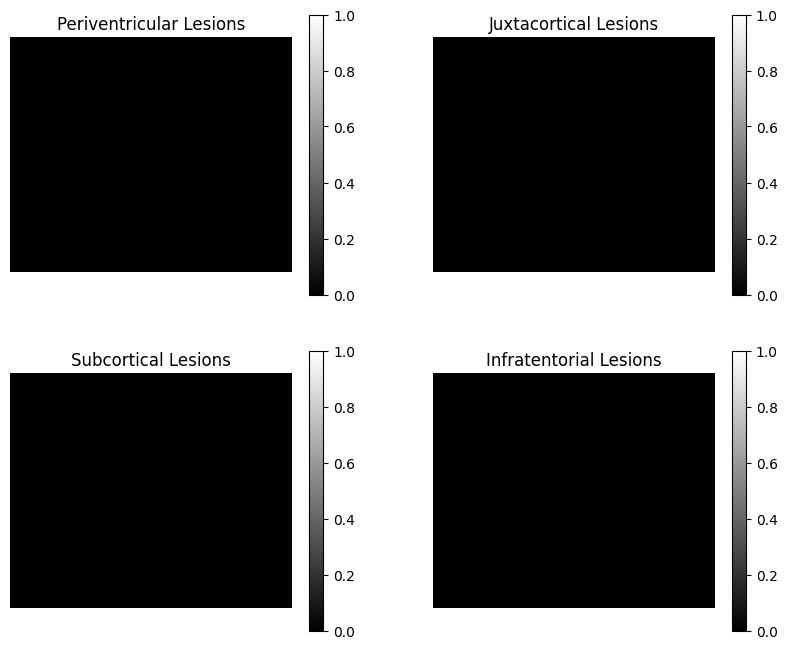

In [62]:
bsl_lesion_pv, bsl_lesion_jc, bsl_lesion_sc, bsl_lesion_it = seperate_lesion_type(bsl_lesion_mask)
visualize_lesion_types(bsl_lesion_pv, bsl_lesion_jc, bsl_lesion_sc, bsl_lesion_it)

Running 3D Farneback optical flow with the following parameters:
Iters: 5 | Levels: 5 | Scale: 0.5 | Kernel: 9 | Filter: box-21 | Presmoothing: None
vz shape (182, 218, 182), vy shape (182, 218, 182), vx shape (182, 218, 182), confidence shape (182, 218, 182)


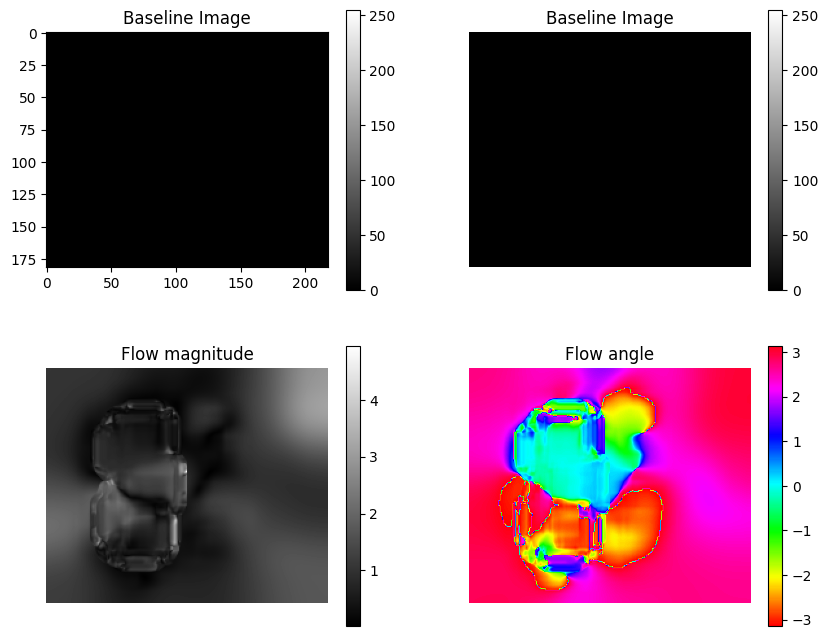

In [75]:
"""Farneback3D class used to instantiate the algorithm with its parameters.

Args:
    iters (int): number of iterations. Defaults to 5
    num_levels (int): number of pyramid levels. Defaults to 5
    scale (float): Scaling factor used to generate the pyramid levels. Defaults to 0.5
    spatial_size (int): size of the support used in the calculation of the standard deviation of the Gaussian
        applicability. Defaults to 9.
    sigma_k (float): scaling factor used to calculate the standard deviation of the Gaussian applicability. The
        formula to calculate sigma is sigma_k*(spatial_size - 1). Defaults to 0.15.
    filter_type (str): Defines the type of filter used to average the calculated matrices. Defaults to "box"
    filter_size (int): Size of the filter used to average the matrices. Defaults to 21
    presmoothing (int): Standard deviation used to perform Gaussian smoothing of the images. Defaults to None
    device_id (int): Device id of the GPU. Defaults to 0
"""
farneback = opticalflow3D.Farneback3D()
vz, vy, vx, confidence = compute_optical_flow(bsl_img, w24_img)
print(f"vz shape {vz.shape}, vy shape {vy.shape}, vx shape {vx.shape}, confidence shape {confidence.shape}")

# visualize the flow field

# visualize_flow_field(vz, vy, vx)

visualize_flow_mag_angle(bsl_img, w24_img, vz, vy, vx)


In [61]:

# get bounding box of the lesion
objects = get_lesion_bounding_boxes(bsl_lesion_mask)

# get the flow vectors for each lesion
per_lesion_flow = get_per_lesion_flow(bsl_lesion_mask, vz, vy, vx)

# visualize the flow vectors in 3d, only leave the flow of the lesion area
def visualize_lesions_flow_3d(per_lesion_flow):
    fig = plt.figure()
    fig.set_size_inches(12, 8)
    ax = fig.add_subplot(111, projection='3d')

    for _, obj, vz_lesion, vy_lesion, vx_lesion in per_lesion_flow:
        # get the bounding box of the lesion
        z, y, x = obj
        # get the flow vectors within the bounding box
        x, y, z = np.meshgrid(x, y, z)
        ax.quiver(x, y, z, vx_lesion, vy_lesion, vz_lesion, length=0.1, normalize=True)

    ax.set_title("Optical Flow Vectors")
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")

    plt.show()
    


# new_lesions, resolved_lesions, unchanged_lesions, growing_lesions, shrinking_lesions = compute_lesion_change_stats(bsl_lesion_mask, w24_lesion_mask)

# print(f"""
# new_lesions: {new_lesions}
# resolved_lesions: {resolved_lesions}
# unchanged_lesions: {unchanged_lesions}
# growing_lesions: {growing_lesions}
# shrinking_lesions: {shrinking_lesions}
# """)




[(0, 7), (1, 3), (2, 2), (3, 3), (4, 4), (5, 5), (6, 2), (7, 5), (8, 4), (9, 11), (10, 12), (11, 29), (12, 17), (13, 16), (14, 19), (15, 20), (16, 17), (17, 22), (18, 33), (19, 30), (20, 31), (21, 22), (22, 27), (23, 35), (24, 30), (25, 36), (26, 37), (27, 39), (28, 40), (29, 35), (30, 40), (31, 13), (32, 46), (33, 36), (34, 43), (35, 40), (36, 47), (37, 51), (38, 50), (39, 49), (40, 50), (41, 52), (42, 67), (43, 48), (44, 51), (45, 67), (46, 54), (47, 59), (48, 58), (49, 56), (50, 64), (51, 60), (52, 68), (53, 62), (54, 64), (55, 53), (56, 64), (57, 66), (58, 68), (59, 65), (60, 66), (61, 64), (62, 68), (63, 64), (64, 70), (65, 73), (66, 73), (67, 73), (68, 58), (69, 77), (70, 77), (71, 88), (72, 78), (73, 82), (74, 80), (75, 48), (76, 85), (77, 48), (78, 88), (79, 87), (80, 86), (81, 86)]

new_lesions: 9
resolved_lesions: -9
unchanged_lesions: 91
growing_lesions: 46
shrinking_lesions: 34

